In [1]:
using Plots
using CSV
using DataFrames
using Glob
using JLD2
using ProgressMeter
using Printf

In [ ]:
df1 = CSV.read("two_body.dat", DataFrame);
plot(df1[:, "x1"], df1[:, "y1"], ms=0.1)
plot!(df1[:, "x2"], df1[:, "y2"], ms=0.1)


In [7]:
df1

Row,t,x1,y1,x2,y2
,Float64,Float64,Float64,Float64,Float64
1,0.0,4.47913e-13,-2.99772e-18,10.0,-0.000133853


In [6]:
particles = []

for file in glob("data/*.dat")
    df = CSV.read(file, DataFrame)[1:1:end, :]
    push!(particles, df)
end

In [6]:
using GalaxySim

[ Info: Precompiling GalaxySim [acb07f55-bd29-4b0d-84d7-cda6267f5828]


In [7]:
N = length(particles)
Nt = size(particles[1])[1]


function get_col(col)
    arr = zeros(N, Nt)
    
    for n in 1:N
        for i in 1:Nt
            arr[n, i] = particles[n][i, col]
        end
    end
    return arr
end


get_col (generic function with 1 method)

In [8]:
x1s = get_col("x1")
x2s = get_col("x2");
ρs = get_col("ρ")

100×1563 Matrix{Float64}:
 0.0290924   0.029758    0.0303861   …  1.47759e-8  1.47759e-8  1.47759e-8
 1.47759e-8  2.9624e-7   2.9624e-7      2.92772e-7  2.92772e-7  2.92772e-7
 1.47759e-8  1.47759e-8  1.47759e-8     5.60646e-8  5.60646e-8  5.60646e-8
 0.00139998  0.00139998  0.00575116     1.47759e-8  1.47759e-8  1.47759e-8
 0.903276    0.903886    0.834733       6.18597e-8  6.18597e-8  6.18597e-8
 0.00333024  0.00333024  0.00455778  …  1.47759e-8  1.47759e-8  1.47759e-8
 1.89856     1.95414     1.85206        6.37017e-7  6.37017e-7  6.37017e-7
 0.0101184   0.0134      0.0133521      7.43876e-7  7.43876e-7  7.43876e-7
 0.0475742   0.0474263   0.0473834      7.13023e-7  7.13023e-7  7.13023e-7
 1.47759e-8  8.29553e-6  8.29553e-6     9.72216e-8  9.72216e-8  9.72216e-8
 1.47759e-8  1.47759e-8  1.47759e-8  …  1.47759e-8  1.47759e-8  1.47759e-8
 0.0139469   0.0164261   0.0248741      1.47759e-8  1.47759e-8  1.47759e-8
 1.11112     1.15538     1.19842        3.98732e-8  3.98732e-8  3.98732e-8

Progress: 100%|█████████████████████████████████████████| Time: 0:00:34
[ Info: Saved animation to /home/daniel/.julia/dev/GalaxySim/tmp.gif


Plots.AnimatedGif("/home/daniel/.julia/dev/GalaxySim/tmp.gif")
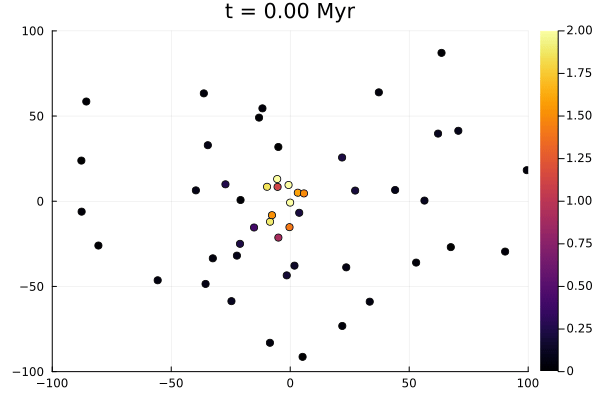

In [9]:
prog = Progress(Nt)

Rv = 100

function plot_gal(x, y, c, Rv, t)    
    scatter(x, y, marker_z=c, clim=(0, 2), xlim=[-Rv, Rv], ylim=[-Rv, Rv], legend=false, colorbar=true)
    title!(@sprintf("t = %2.2f Myr", t/1e6yr))  
end


@gif for i ∈ 1:1:Nt
    filt = x1s[:, i] .< Rv
    plot_gal(x1s[filt, i], x2s[filt, i], ρs[filt, i], Rv, i)
    next!(prog)
end